# Data preprocessing of updated Udacity dataset

In [ ]:
# At a first look, the dataset contains 22241 images from which we have the follwing classes 
# with their corresponding number of instances (appearances within images):
# car - 127900
# truck - 7194
# pedestrian - 21491
# trafficLight-Red - 13673
# trafficLight-RedLeft - 3482
# trafficLight-Yellow - 541
# trafficLight-YellowLeft - 28
# trafficLight-Green - 10838
# trafficLight - 5101
# biker - 3704
# For creating a balanced dataset we dropped the labels for biker and truck as they were very little compared to the
# other classes and merge the classes containg trafficLights
# We obtained the following classes with their corresponding instances:
# car - 127900
# pedestrian - 21491
# trafficLight - 34277
# Note: around 3000 images from the total were found to be background images (with no classes in them)
# !truck will be updated as car

In [1]:
import os
os.chdir('C:\\Users\\andre\\Desktop\\Object detection project\\TFODCourse')
os.chdir('Tensorflow\\workspace\\export')

In [2]:
# Converting the already created .json file back into a dictionary in order to see which images contain pedestrians/trafficLights and cars
# and delete the rest of the images, for balancing the labels
# importing the module
import json
 
# Opening JSON file
with open('_dictionary.json') as json_file:
    data = json.load(json_file)
    
# Print the type of data variable
# print("Type:", type(data))

In [52]:
# We noticed that in roboflow dataset there are 28000 images but only around 26000 are annotated
# Moving the annotaed images to a separate folder
os.chdir('C:\\Users\\andre\\Desktop\\Object detection project\\TFODCourse')
os.chdir('Tensorflow\\workspace\\export')
for names in data.keys():
    shutil.move(names, 'labeled')

### Pedestrians

In [26]:
# Iterating through the dictionary and creating another one where only the the labels for traffic light appear
trafficLights_filename = []
count_trafficLights = 0
for filename in data.keys():
    for label in data.get(filename):
        if label == "trafficLight":
            count_trafficLights += 1
            trafficLights_filename.append(filename)
# trafficLight could have appeared multiple times as a value in the same key, so we have to make a list with unique filenames
trafficLights_filename = list(set(trafficLights_filename))
# 34277 labels for trafficLight in 9741 images

In [30]:
# Count how many times the label for cars appear where trafficLight appears
count_cars_light = 0
for filename in trafficLights_filename:
    for label in data.get(filename):
        if label == "car":
            count_cars_light += 1
# 53079 cars and 34277 trafficLights in 9741 images

### TrafficLight

In [28]:
# Iterating through the dictionary and creating another one where only the the labels for pedestrian appear
pedestrian_filename = []
count_pedestrians = 0
for filename in data.keys():
    for label in data.get(filename):
        if label == "pedestrian":
            count_pedestrians += 1
            pedestrian_filename.append(filename)
# pedestrian could have appeared multiple times as a value in the same key, so we have to make a list with unique filenames
pedestrian_filename = list(set(pedestrian_filename))
# 21491 labels for trafficLight in 7030 images

In [32]:
# Count how many times the label for cars appear where pedestrian appears
count_cars_pedestrians = 0
for filename in pedestrian_filename:
    for label in data.get(filename):
        if label == "car":
            count_cars_pedestrians += 1
# 37264 cars and 21491 pedestrians in 7030 images
# 56425 rows + 1

### Pedestrians & TrafficLight

In [3]:
# Create a datset with both pedestrians and traffic lights
# Iterating through the dictionary and creating another one where only the the labels for traffic light OR pedestrian appear
lights_and_pedestrians_filename = []
count_tl_pd = 0
for filename in data.keys():
    for label in data.get(filename):
        if label == "trafficLight" or label == "pedestrian":
            count_tl_pd += 1
            lights_and_pedestrians_filename.append(filename)
# trafficLight could have appeared multiple times as a value in the same key, so we have to make a list with unique filenames
lights_and_pedestrians_filename = list(set(lights_and_pedestrians_filename))
# 55768 traffic lights (34277) and pedestrians (21491) in 13033 images

In [4]:
# Count how many times the label for cars appear where pedestrian OR traffic lights appear
count_cars_tl_pd = 0
for filename in lights_and_pedestrians_filename:
    for label in data.get(filename):
        if label == "car":
            count_cars_tl_pd += 1
# 69990 cars, 34277 traffic lights, 21491 pedestrians in 13033 images

## Creating a dataset with pedestrians and cars & trafficLight

In [9]:
# import shutil
# # Moving the training images with cars and pedestrian to another folder
# for file in pedestrian_filename:
#     shutil.move(file, 'pedestrians_and_cars')

import shutil
# Moving the training images with cars and pedestrian to another folder
for file in lights_and_pedestrians_filename:
    shutil.move(file, 'pedestrians_and_trafficLights')

In [6]:
import pandas as pd
# Creating a separate .csv file for the new datset
old_csv = pd.read_csv('_annotations.csv')
# print(type(new_csv))

In [7]:
# # Opening an empty .csv and writing only the images that are needed
# new_csv = pd.read_csv('_out.csv')
# # df1 = df1.append(new_csv.iloc[2], ignore_index = True)
# for index, filename in enumerate(old_csv["filename"]):
#     for name in pedestrian_filename:
#         if filename == name:
#             new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
# new_csv.to_csv('_out.csv')

new_csv = pd.read_csv('_out.csv')
# df1 = df1.append(new_csv.iloc[2], ignore_index = True)
for index, filename in enumerate(old_csv["filename"]):
    for name in lights_and_pedestrians_filename:
        if filename == name:
            new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
new_csv.to_csv('_out.csv')

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  new_csv = new_csv.append(old_csv.iloc[index], ignore_index = True)
C:\Users\andre\AppData\Local\Temp\ipykernel_4412\3682575163.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat in

In [10]:
# Move images to test and validation and generate valid.csv and train.csv
# import glob
# import random
# os.chdir('C:\\Users\\andre\\Desktop\\Object detection project\\TFODCourse\\Tensorflow\\workspace\\export\\pedestrians_and_cars')
# no_img_id = 7030
# for c in random.sample(glob.glob('14*'), round(no_img_id*0.1)):
#     shutil.move(c, 'valid')
# for c in random.sample(glob.glob('14*'), round(no_img_id*0.1)):
#     shutil.move(c, 'test')

import glob
import random
os.chdir('C:\\Users\\andre\\Desktop\\Object detection project\\TFODCourse\\Tensorflow\\workspace\\export\\pedestrians_and_trafficLights')
no_img_id = 13033
for c in random.sample(glob.glob('14*'), round(no_img_id*0.1)):
    shutil.move(c, 'valid')
for c in random.sample(glob.glob('14*'), round(no_img_id*0.1)):
    shutil.move(c, 'test')

In [11]:
# Creating a list of filenames from a certain directory
def getListOfFiles(dirName):
    # create a list of file and sub directories 
    # names in the given directory 
    listOfFile = os.listdir(dirName)
    allFiles = list()
    # Iterate over all the entries
    for entry in listOfFile:
        # Create full path
        fullPath = os.path.join(dirName, entry)
        # If entry is a directory then get the list of files in this directory 
        if os.path.isdir(fullPath):
            allFiles = allFiles + getListOfFiles(fullPath)
        else:
            allFiles.append(fullPath)
    return allFiles

In [12]:
# Getting the names of files from the valid directory and saving them in a list
dirName = 'valid';
# Get the list of all files in directory tree at given path
listOfFiles_valid = getListOfFiles(dirName)

In [13]:
# Saving the list of validation in a .csv file
df_valid = pd.DataFrame(listOfFiles_valid) 
# saving the dataframe 
df_valid.to_csv('valid.csv') 

In [15]:
# Getting the names of files from the train directory and saving them in a list
dirName = 'train';
# Get the list of all files in directory tree at given path
listOfFiles_test = getListOfFiles(dirName)

In [16]:
# Saving the list of test in a .csv file
df_test = pd.DataFrame(listOfFiles_test) 
# saving the dataframe 
df_test.to_csv('train.csv') 

## Generating tf records

In [26]:
import os
os.chdir(".\..")
os.getcwd()

'C:\\Users\\andre\\Desktop\\Object detection project\\TFODCourse'

#### Change the paths and labels accordingly

In [28]:
# Generating tf-records for training dataset
train_csv_path = 'Tensorflow\\workspace\\export\\pedestrians_and_trafficLights\\train.csv'
train_tfr_path = 'Tensorflow\\workspace\\export\\pedestrians_and_trafficLights\\train.record'
train_img_path = 'Tensorflow\\workspace\\export\\pedestrians_and_trafficLights\\train'

In [29]:
"""
NOTE: annotation.txt should be in this format:
filename;class;xmin;ymin;xmax;ymax

Usage:
python3 new_annotations2tfrecords-converter.py \
--csv_input=/media/pchat/Data/datasets/SKU/no_scan_training/training_images/TF_RECORD_annotation.txt \
--output_path=/media/pchat/Data/Documents/Code/tf2/tf_records/no_scan_sku/tf-experiment-training.record \
--image_dir=/media/pchat/Data/datasets/SKU/no_scan_training/training_images/
"""
from __future__ import division
from __future__ import print_function
from __future__ import absolute_import

import os
import io
import pandas as pd
import tensorflow as tf

from PIL import Image
from object_detection.utils import dataset_util
from collections import namedtuple, OrderedDict

flags = tf.compat.v1.flags
flags.DEFINE_string('csv_input1', train_csv_path, 'Path to the CSV input')
flags.DEFINE_string('output_path1', train_tfr_path, 'Path to output TFRecord')
flags.DEFINE_string('image_dir1', train_img_path, 'Path to images')
FLAGS = flags.FLAGS


# TO-DO replace this with label map
def class_text_to_int(row_label):
#     if row_label == 'background':
#         return 0
    if row_label == 'car':
        return 1
    if row_label == 'pedestrian':
        return 2
    if row_label == 'trafficLight':
        return 3
    else:
        None


def split(df, group):
    data = namedtuple('data', ['filename', 'object'])
    gb = df.groupby(group)
    return [data(filename, gb.get_group(x)) for filename, x in zip(gb.groups.keys(), gb.groups)]


def create_tf_example(group, path):
    with tf.io.gfile.GFile(os.path.join(path, "{}".format(group.filename)), 'rb') as fid:
        encoded_jpg = fid.read()
    encoded_jpg_io = io.BytesIO(encoded_jpg)
    image = Image.open(encoded_jpg_io)
    width, height = image.size

    filename = group.filename.encode('utf8')
    image_format = b'jpg'
    xmins = []
    xmaxs = []
    ymins = []
    ymaxs = []
    classes_text = []
    classes = []

    for index, row in group.object.iterrows():
        xmins.append(row['xmin'] / width)
        xmaxs.append(row['xmax'] / width)
        ymins.append(row['ymin'] / height)
        ymaxs.append(row['ymax'] / height)
        classes_text.append(row['class'].encode('utf8'))
        classes.append(class_text_to_int(row['class']))

    tf_example = tf.train.Example(features=tf.train.Features(feature={
        'image/height': dataset_util.int64_feature(height),
        'image/width': dataset_util.int64_feature(width),
        'image/filename': dataset_util.bytes_feature(filename),
        'image/source_id': dataset_util.bytes_feature(filename),
        'image/encoded': dataset_util.bytes_feature(encoded_jpg),
        'image/format': dataset_util.bytes_feature(image_format),
        'image/object/bbox/xmin': dataset_util.float_list_feature(xmins),
        'image/object/bbox/xmax': dataset_util.float_list_feature(xmaxs),
        'image/object/bbox/ymin': dataset_util.float_list_feature(ymins),
        'image/object/bbox/ymax': dataset_util.float_list_feature(ymaxs),
        'image/object/class/text': dataset_util.bytes_list_feature(classes_text),
        'image/object/class/label': dataset_util.int64_list_feature(classes),
    }))
    return tf_example


def main(_):
    
    writer = tf.io.TFRecordWriter(FLAGS.output_path1)

    
    path = os.path.join(FLAGS.image_dir1)

    
    examples = pd.read_csv(FLAGS.csv_input1, sep=";")

    
    grouped = split(examples, 'filename')
    
    #print(grouped)
    for group in grouped:
        
        tf_example = create_tf_example(group, path)
        writer.write(tf_example.SerializeToString())

    writer.close()
    output_path1 = os.path.join(os.getcwd(), FLAGS.output_path1)
    print('Successfully created the TFRecords: {}'.format(output_path1))


if __name__ == '__main__':
    #tf.app.run()
    tf.compat.v1.app.run()
    #main()

Successfully created the TFRecords: C:\Users\andre\Desktop\Object detection project\TFODCourse\Tensorflow\workspace\export\pedestrians_and_trafficLights\train.record


SystemExit: 

C:\Users\andre\Desktop\Object detection project\TFODCourse\tfod\lib\site-packages\IPython\core\interactiveshell.py:3405: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


#### Change the paths and labels accordingly

In [30]:
# Generating tf-records for training dataset
valid_csv_path = 'Tensorflow\\workspace\\export\\pedestrians_and_trafficLights\\valid.csv'
valid_tfr_path = 'Tensorflow\\workspace\\export\\pedestrians_and_trafficLights\\valid.record'
valid_img_path = 'Tensorflow\\workspace\\export\\pedestrians_and_trafficLights\\valid'

In [31]:
"""
NOTE: annotation.txt should be in this format:
filename;class;xmin;ymin;xmax;ymax

Usage:
python3 new_annotations2tfrecords-converter.py \
--csv_input=/media/pchat/Data/datasets/SKU/no_scan_training/training_images/TF_RECORD_annotation.txt \
--output_path=/media/pchat/Data/Documents/Code/tf2/tf_records/no_scan_sku/tf-experiment-training.record \
--image_dir=/media/pchat/Data/datasets/SKU/no_scan_training/training_images/
"""
from __future__ import division
from __future__ import print_function
from __future__ import absolute_import

import os
import io
import pandas as pd
import tensorflow as tf

from PIL import Image
from object_detection.utils import dataset_util
from collections import namedtuple, OrderedDict

flags = tf.compat.v1.flags
flags.DEFINE_string('csv_input2', valid_csv_path, 'Path to the CSV input')
flags.DEFINE_string('output_path2', valid_tfr_path, 'Path to output TFRecord')
flags.DEFINE_string('image_dir2', valid_img_path, 'Path to images')
FLAGS = flags.FLAGS


# TO-DO replace this with label map
def class_text_to_int(row_label):
#     if row_label == 'background':
#         return 0
    if row_label == 'car':
        return 1  
    if row_label == 'pedestrian':
        return 2
    if row_label == 'trafficLight':
        return 3
    else:
        None


def split(df, group):
    data = namedtuple('data', ['filename', 'object'])
    gb = df.groupby(group)
    return [data(filename, gb.get_group(x)) for filename, x in zip(gb.groups.keys(), gb.groups)]


def create_tf_example(group, path):
    with tf.io.gfile.GFile(os.path.join(path, "{}".format(group.filename)), 'rb') as fid:
        encoded_jpg = fid.read()
    encoded_jpg_io = io.BytesIO(encoded_jpg)
    image = Image.open(encoded_jpg_io)
    width, height = image.size

    filename = group.filename.encode('utf8')
    image_format = b'jpg'
    xmins = []
    xmaxs = []
    ymins = []
    ymaxs = []
    classes_text = []
    classes = []

    for index, row in group.object.iterrows():
        xmins.append(row['xmin'] / width)
        xmaxs.append(row['xmax'] / width)
        ymins.append(row['ymin'] / height)
        ymaxs.append(row['ymax'] / height)
        classes_text.append(row['class'].encode('utf8'))
        classes.append(class_text_to_int(row['class']))

    tf_example = tf.train.Example(features=tf.train.Features(feature={
        'image/height': dataset_util.int64_feature(height),
        'image/width': dataset_util.int64_feature(width),
        'image/filename': dataset_util.bytes_feature(filename),
        'image/source_id': dataset_util.bytes_feature(filename),
        'image/encoded': dataset_util.bytes_feature(encoded_jpg),
        'image/format': dataset_util.bytes_feature(image_format),
        'image/object/bbox/xmin': dataset_util.float_list_feature(xmins),
        'image/object/bbox/xmax': dataset_util.float_list_feature(xmaxs),
        'image/object/bbox/ymin': dataset_util.float_list_feature(ymins),
        'image/object/bbox/ymax': dataset_util.float_list_feature(ymaxs),
        'image/object/class/text': dataset_util.bytes_list_feature(classes_text),
        'image/object/class/label': dataset_util.int64_list_feature(classes),
    }))
    return tf_example


def main(_):
    
    writer = tf.io.TFRecordWriter(FLAGS.output_path2)

    
    path = os.path.join(FLAGS.image_dir2)

    
    examples = pd.read_csv(FLAGS.csv_input2, sep=";")

    
    grouped = split(examples, 'filename')
    
    #print(grouped)
    for group in grouped:
        
        tf_example = create_tf_example(group, path)
        writer.write(tf_example.SerializeToString())

    writer.close()
    output_path2 = os.path.join(os.getcwd(), FLAGS.output_path2)
    print('Successfully created the TFRecords: {}'.format(output_path2))


if __name__ == '__main__':
    #tf.app.run()
    tf.compat.v1.app.run()
    #main()

Successfully created the TFRecords: C:\Users\andre\Desktop\Object detection project\TFODCourse\Tensorflow\workspace\export\pedestrians_and_trafficLights\valid.record


SystemExit: 

C:\Users\andre\Desktop\Object detection project\TFODCourse\tfod\lib\site-packages\IPython\core\interactiveshell.py:3405: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


In [39]:
os.chdir('.\..')
os.getcwd()

'C:\\Users\\andre\\Desktop\\Object detection project\\TFODCourse\\Tensorflow\\workspace\\export'

## Archiving to tar.gz

In [6]:
TRAIN_PATH = os.path.join('pedestrians_and_trafficLights', 'train')
TEST_PATH = os.path.join('pedestrians_and_trafficLights', 'test')
VALID_PATH = os.path.join('pedestrians_and_trafficLights', 'valid')
ARCHIVE_PATH = os.path.join('pedestrians_and_trafficLights', 'archive_v4.tar.gz')
# !tar -czf {ARCHIVE_PATH} {TRAIN_PATH} {TEST_PATH} {VALID_PATH}
!tar -czf {ARCHIVE_PATH} {TRAIN_PATH} {VALID_PATH} {TEST_PATH}

## Plotting one image with its bounding boxes

In [2]:
os.chdir('Tensorflow\\workspace\\export\\pedestrians_and_trafficLights\\train')
os.getcwd()

'C:\\Users\\andre\\Desktop\\Object detection project\\TFODCourse\\Tensorflow\\workspace\\export'

In [18]:
# import pandas as pd
valid_labels = pd.read_csv('valid.csv')
valid_labels.head()

,filename,class,xmin,ymin,xmax,ymax
0,1478898326312239784_jpg.rf.68d1e82fac5c6363931...,car,44,261,81,294
1,1478898326312239784_jpg.rf.68d1e82fac5c6363931...,pedestrian,0,264,9,303
2,1478898326312239784_jpg.rf.68d1e82fac5c6363931...,pedestrian,6,264,16,302
3,1478898326312239784_jpg.rf.68d1e82fac5c6363931...,pedestrian,7,266,15,302
4,1478898326312239784_jpg.rf.68d1e82fac5c6363931...,car,85,229,253,440


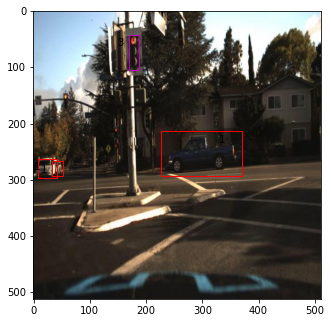

In [20]:
import matplotlib.pyplot as plt
%matplotlib inline
from matplotlib import patches
from PIL import Image, ImageDraw
import xml.etree.ElementTree as ET

fig = plt.figure()

#add axes to the image
ax = fig.add_axes([0,0,1,1])

# read and plot the image
img_name = '1478019978180101986_jpg.rf.6c0f636cd3a8a0bf74853f505bd2f776.jpg'
image = plt.imread(img_name)
plt.imshow(image)

# iterating over the image for different objects
for _,row in valid_labels[valid_labels.filename == img_name].iterrows():
    xmin = row.xmin
    xmax = row.xmax
    ymin = row.ymin
    ymax = row.ymax
    
    width = xmax - xmin
    height = ymax - ymin
    
    # assign different color to different classes of objects
    if row[1] == 'car':
        edgecolor = 'r'
        ax.annotate('1', xy=(xmax-40,ymin+20))
    elif row[1] == 'pedestrian':
        edgecolor = 'b'
        ax.annotate('2', xy=(xmax-40,ymin+20))
    elif row[1] == 'trafficLight':
        edgecolor = 'm'
        ax.annotate('3', xy=(xmax-40,ymin+20))
        
    # add bounding boxes to the image
    rect = patches.Rectangle((xmin,ymin), width, height, edgecolor = edgecolor, facecolor = 'none')
    
    ax.add_patch(rect)

### Plotting a distribution of the width over height ratio of ground truth boxes

Text(0, 0.5, 'Number of boxes')

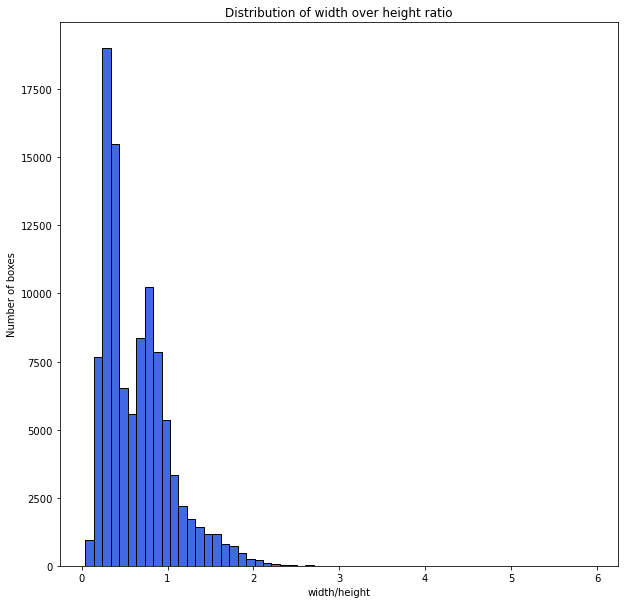

In [7]:
import os
# os.chdir('Tensorflow/workspace/export/pedestrians_and_trafficLights/train')
import pandas as pd
import matplotlib.pyplot as plt
train_csv = pd.read_csv('train.csv')
xmin = []
xmax = []
ymin = []
ymax = []
for i in range(100748):
    xmin.append(train_csv.xmin[i])
    xmax.append(train_csv.xmax[i])
    ymin.append(train_csv.ymin[i])
    ymax.append(train_csv.ymax[i])
width = []
height = []
ratio = []
for i in range(100748):
    width.append(xmax[i] - xmin[i])
    height.append(ymax[i] - ymin[i])
    ratio.append(width[i]/height[i])

# matplotlib histogram
plt.rcParams['figure.figsize'] = [10, 10]
plt.hist(ratio, color = '#4169E1', edgecolor = 'black',
         bins = 60)
plt.title('Distribution of width over height ratio')
plt.xlabel('width/height')
plt.ylabel('Number of boxes')

Text(0, 0.5, 'Number of boxes')

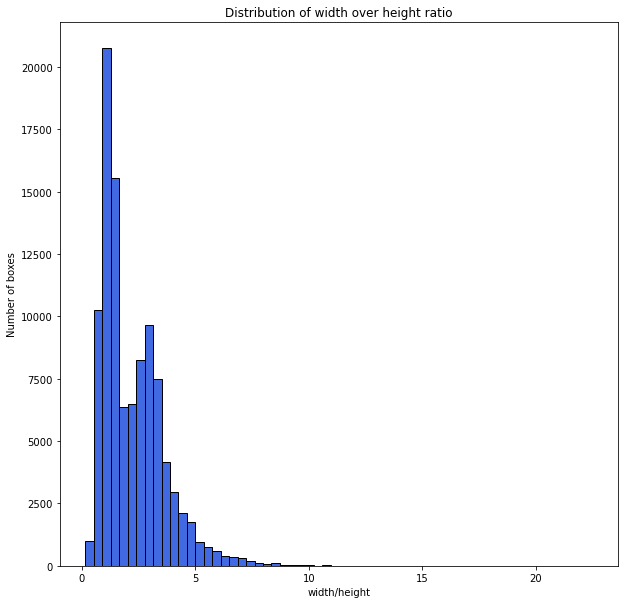

In [4]:
import os
os.chdir('Tensorflow/workspace/export/pedestrians_and_trafficLights/train')
import pandas as pd
import matplotlib.pyplot as plt
train_csv = pd.read_csv('train.csv')
xmin = []
xmax = []
ymin = []
ymax = []
for i in range(100748):
    xmin.append(train_csv.xmin[i])
    xmax.append(train_csv.xmax[i])
    ymin.append(train_csv.ymin[i])
    ymax.append(train_csv.ymax[i])
width = []
height = []
ratio = []
for i in range(100748):
    width.append(xmax[i] - xmin[i])
    height.append(ymax[i] - ymin[i])
    ratio.append(height[i]/width[i])

# matplotlib histogram
plt.rcParams['figure.figsize'] = [10, 10]
plt.hist(ratio, color = '#4169E1', edgecolor = 'black',
         bins = 60)
plt.title('Distribution of width over height ratio')
plt.xlabel('width/height')
plt.ylabel('Number of boxes')

### Creating a scatter distribution. Linear regression

Text(0, 0.5, 'Width')

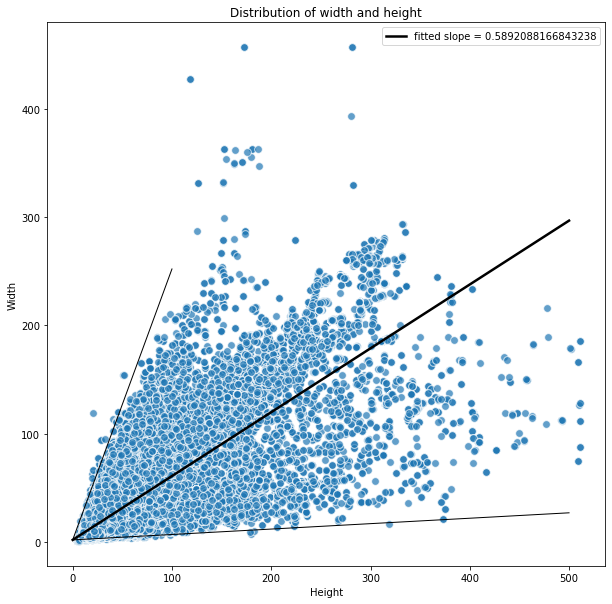

In [15]:
from matplotlib import pyplot 
import numpy as np
import os
# os.chdir('Tensorflow/workspace/export/pedestrians_and_trafficLights/train')
import pandas as pd
import matplotlib.pyplot as plt
train_csv = pd.read_csv('train.csv')
xmin = []
xmax = []
ymin = []
ymax = []
for i in range(100748):
    xmin.append(train_csv.xmin[i])
    xmax.append(train_csv.xmax[i])
    ymin.append(train_csv.ymin[i])
    ymax.append(train_csv.ymax[i])
width = []
height = []
for i in range(100748):
    width.append(xmax[i] - xmin[i])
    height.append(ymax[i] - ymin[i])
# Generate data
x = height 
# rng.uniform(0, 10, size=100)
y = width 
# x + rng.normal(size=100)

# Initialize layout
fig, ax = plt.subplots(figsize = (10, 10))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="w")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(0, 500, num=100)
xseq2 = np.linspace(0, 100, num=300)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5, label='fitted slope = 0.5892088166843238')
ax.plot(xseq, a + 0.05 * xseq, color="k", lw=1)
ax.plot(xseq2, a + 2.5 * xseq2, color="k", lw=1)
ax.legend()
plt.title('Distribution of width and height')
plt.xlabel('Height')
plt.ylabel('Width')

In [2]:
from scipy.stats import linregress
linregress(x, y)

LinregressResult(slope=0.5892088166843238, intercept=2.097784493077821, rvalue=0.780535933542184, pvalue=0.0, stderr=0.0014866868899519612, intercept_stderr=0.10694887111675949)

In [27]:
len(b_values)

100748

Text(0, 0.5, 'Number of boxes')

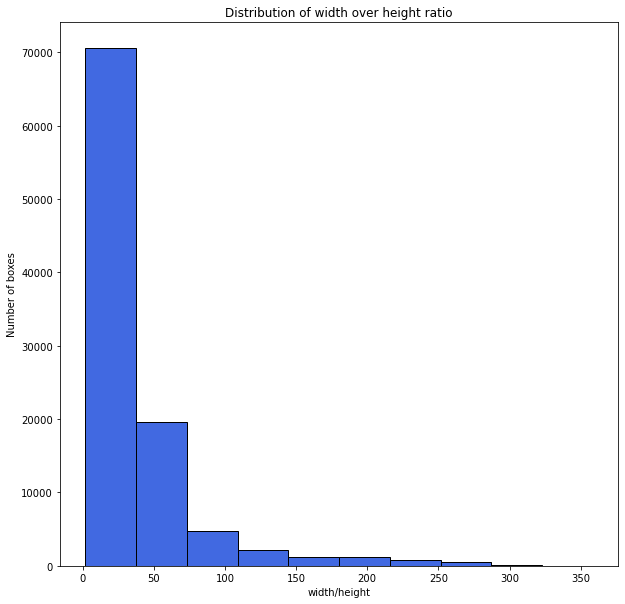

In [5]:
import os
# os.chdir('Tensorflow/workspace/export/pedestrians_and_trafficLights/train')
import math
import pandas as pd
import matplotlib.pyplot as plt
train_csv = pd.read_csv('train.csv')
xmin = []
xmax = []
ymin = []
ymax = []
for i in range(100748):
    xmin.append(train_csv.xmin[i])
    xmax.append(train_csv.xmax[i])
    ymin.append(train_csv.ymin[i])
    ymax.append(train_csv.ymax[i])
width = []
height = []
ratio = []
for i in range(100748):
    width.append(xmax[i] - xmin[i])
    height.append(ymax[i] - ymin[i])
    ratio.append(math.sqrt(height[i]*width[i]))

# matplotlib histogram
plt.rcParams['figure.figsize'] = [10, 10]
plt.hist(ratio, color = '#4169E1', edgecolor = 'black',
         bins = 10)
plt.title('Distribution of width over height ratio')
plt.xlabel('width/height')
plt.ylabel('Number of boxes')